<a href="https://colab.research.google.com/github/saikat-roy/Adv-DL-for-Graphics/blob/master/Assignment2/Assignment2_ADLG.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [0]:
import os
import math
import numpy as np
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torch.autograd import Variable
from torch.utils.data import DataLoader, Subset
from torchvision import datasets
import torchvision.transforms as transforms
from torchvision.utils import save_image, make_grid
from torchsummary import summary
import matplotlib.pyplot as plt

In [0]:
nc = 3
ndf = 64
ngf = 128


class Generator(nn.Module):

    def __init__(self):
        super(Generator, self).__init__()
        self.block = nn.Sequential(

            nn.ConvTranspose2d(nz, 512, 4, 1, 0, bias=False),
            nn.BatchNorm2d(512),
            nn.ReLU(),
            # nn.LeakyReLU(0.2,True),

            nn.ConvTranspose2d(512, 256, 4, 2, 1, bias=False),
            nn.BatchNorm2d(256),
            nn.ReLU(),
            # nn.LeakyReLU(0.2,True),

            nn.ConvTranspose2d(256, 128, 4, 2, 1, bias=False),
            nn.BatchNorm2d(128),
            # nn.LeakyReLU(0.2,True),
            nn.ReLU(),

            nn.ConvTranspose2d(128, 64, 4, 2, 1, bias=False),
            nn.BatchNorm2d(64),
            # nn.LeakyReLU(0.2,True),
            nn.ReLU(),
            
            nn.ConvTranspose2d(64, 3, 4, 2, 1, bias=False),
            nn.Tanh()
        )

    def forward(self, x):
        x = self.block(x)
        #print(x.size())
        return x


class Discriminator(nn.Module):

    def __init__(self):
        super(Discriminator, self).__init__()
        self.block = nn.Sequential(
            #nn.Dropout2d(0.2),
            nn.Conv2d(3, 16, kernel_size=(3,3),padding=1, bias=False),
            nn.BatchNorm2d(16),
            nn.LeakyReLU(0.2,inplace=True),
            nn.MaxPool2d(kernel_size=2, stride=2),
 
            nn.Conv2d(16, 32, kernel_size=(3, 3), padding=1, bias=False),
            nn.BatchNorm2d(32),
            nn.LeakyReLU(0.2,inplace=True),
            nn.MaxPool2d(kernel_size=2, stride=2),
 
            nn.Conv2d(32, 64, kernel_size=(3,3),padding=1, bias=False),
            nn.BatchNorm2d(64),
            nn.LeakyReLU(0.2,inplace=True),
            nn.MaxPool2d(kernel_size=2, stride=2),
            
            nn.Conv2d(64, 128, kernel_size=(3, 3), padding=1, bias=False),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2, inplace=True),
            nn.MaxPool2d(kernel_size=2, stride=2),
            
            nn.Conv2d(128, 256, kernel_size=(3,3),padding=1, bias=False),            
            nn.AvgPool2d(kernel_size=(4,4)),
            #nn.Linear(512,2)
        )
        self.out = nn.Sequential(nn.Linear(256,1),nn.Sigmoid())

    def forward(self, x):
        x1 = self.block(x)
        x1 = x1.view(x.size(0),-1)
        x = self.out(x1)
        #print(x.size())
        return x

In [0]:
def dataloader_retrieve_indices(dataset):
    select_idx = []
    for idx, (_, y) in enumerate(dataset):
      if y in select_class:
        select_idx.append(idx)
    return select_idx

def dataloaders():
    transforms_list = transforms.Compose([
        transforms.Resize(image_size),
        # transforms.CenterCrop(image_size),
        transforms.ToTensor(),
        transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))
    ])
    os.makedirs('./data/cifar100', exist_ok=True)
    dataset = datasets.CIFAR100('./data/cifar100', train=False, download=True,
                      transform=transforms_list)
    
    select_idx = dataloader_retrieve_indices(dataset)
    
    dataset = Subset(dataset, select_idx)
    print(f"Dataset Length = {len(dataset)}")

    dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=True,
                            drop_last=True)

    return dataloader


def generate_images(gen_model, epoch_no, batch_size=16):
    gen_inp = torch.randn(batch_size, nz, 1, 1, device=device)
    gen_inp = gen_inp.to(device)
    fake_images = gen_model(gen_inp)
    fake_images = fake_images.cpu().detach()
    show(make_grid(fake_images, nrow=8))

    
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

def show(img):
    img = img / 2 + 0.5     # unnormalize
    npimg = img.numpy()
    plt.figure(figsize = (8,8))
    plt.imshow(np.transpose(npimg, (1,2,0)), interpolation='nearest', aspect='auto')
    plt.show()

Selected Classes: ['aquarium_fish' 'beaver' 'camel' 'crab' 'pine_tree']
----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
   ConvTranspose2d-1            [-1, 512, 4, 4]          81,920
       BatchNorm2d-2            [-1, 512, 4, 4]           1,024
              ReLU-3            [-1, 512, 4, 4]               0
   ConvTranspose2d-4            [-1, 256, 8, 8]       2,097,152
       BatchNorm2d-5            [-1, 256, 8, 8]             512
              ReLU-6            [-1, 256, 8, 8]               0
   ConvTranspose2d-7          [-1, 128, 16, 16]         524,288
       BatchNorm2d-8          [-1, 128, 16, 16]             256
              ReLU-9          [-1, 128, 16, 16]               0
  ConvTranspose2d-10           [-1, 64, 32, 32]         131,072
      BatchNorm2d-11           [-1, 64, 32, 32]             128
             ReLU-12           [-1, 64, 32, 32]               0
  ConvTranspose2d-13           

/usr/local/lib/python3.6/dist-packages/torch/nn/modules/loss.py:516: UserWarning: Using a target size (torch.Size([64])) that is different to the input size (torch.Size([64, 1])) is deprecated. Please ensure they have the same size.
  return F.binary_cross_entropy(input, target, weight=self.weight, reduction=self.reduction)


Current Discriminator Accuracy = 36.5
Current Discriminator Positives Accuracy = 10.857142857142858
Current Discriminator Negatives Accuracy = 62.142857142857146
Current Generator Accuracy = 1.8571428571428572
0.9171733941350665 0.6846046192305428
SAMPLE OF TRUE IMAGES..


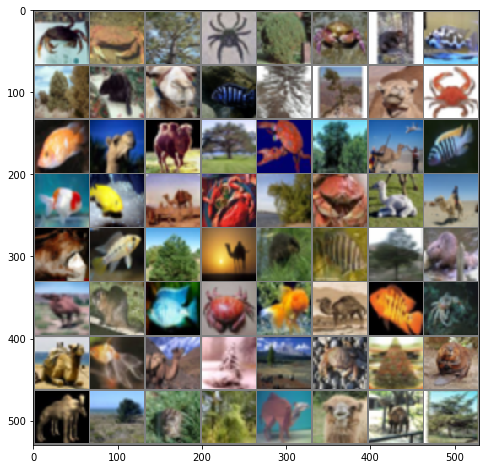

Epoch 1
Current Discriminator Accuracy = 33.5
Current Discriminator Positives Accuracy = 3.0
Current Discriminator Negatives Accuracy = 64.0
Current Generator Accuracy = 0.0
0.9348068237304688 0.7112207242420742
Epoch 2
Current Discriminator Accuracy = 33.92857142857143
Current Discriminator Positives Accuracy = 3.857142857142857
Current Discriminator Negatives Accuracy = 64.0
Current Generator Accuracy = 0.0
0.9169438311031887 0.7021304794720241
Epoch 3
Current Discriminator Accuracy = 37.857142857142854
Current Discriminator Positives Accuracy = 11.714285714285714
Current Discriminator Negatives Accuracy = 64.0
Current Generator Accuracy = 0.0
0.9503876566886902 0.6775639653205872
Epoch 4
Current Discriminator Accuracy = 41.07142857142857
Current Discriminator Positives Accuracy = 18.142857142857142
Current Discriminator Negatives Accuracy = 64.0
Current Generator Accuracy = 0.0
1.0110747984477453 0.6585094077246529
Epoch 5
Current Discriminator Accuracy = 36.357142857142854
Current 

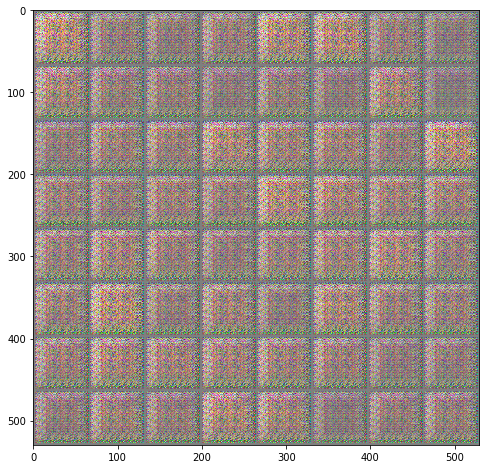

Epoch 10
Current Discriminator Accuracy = 54.85714285714286
Current Discriminator Positives Accuracy = 45.714285714285715
Current Discriminator Negatives Accuracy = 64.0
Current Generator Accuracy = 0.0
1.2291008574622018 0.5532921808106559
Epoch 11
Current Discriminator Accuracy = 59.92857142857143
Current Discriminator Positives Accuracy = 55.857142857142854
Current Discriminator Negatives Accuracy = 64.0
Current Generator Accuracy = 0.0
1.384245412690299 0.4963218995503017
Epoch 12
Current Discriminator Accuracy = 60.785714285714285
Current Discriminator Positives Accuracy = 57.57142857142857
Current Discriminator Negatives Accuracy = 64.0
Current Generator Accuracy = 0.0
1.5204000302723475 0.4668660547052111
Epoch 13
Current Discriminator Accuracy = 61.214285714285715
Current Discriminator Positives Accuracy = 58.42857142857143
Current Discriminator Negatives Accuracy = 64.0
Current Generator Accuracy = 0.0
1.6654459578650338 0.4220978745392391
Epoch 14
Current Discriminator Accura

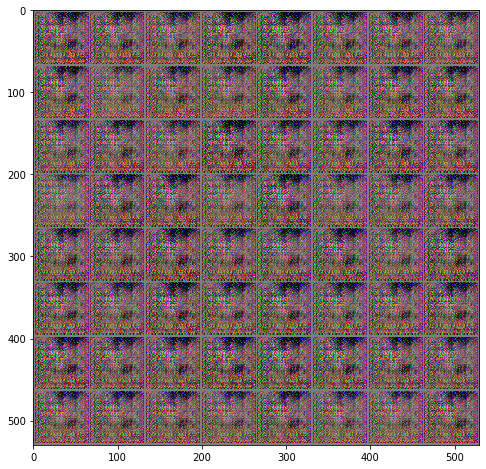

Epoch 20
Current Discriminator Accuracy = 63.85714285714286
Current Discriminator Positives Accuracy = 63.714285714285715
Current Discriminator Negatives Accuracy = 64.0
Current Generator Accuracy = 0.0
2.9409966468811035 0.15778204798698425
Epoch 21
Current Discriminator Accuracy = 64.0
Current Discriminator Positives Accuracy = 64.0
Current Discriminator Negatives Accuracy = 64.0
Current Generator Accuracy = 0.0
3.1671229090009416 0.11950773852212089
Epoch 22
Current Discriminator Accuracy = 64.0
Current Discriminator Positives Accuracy = 64.0
Current Discriminator Negatives Accuracy = 64.0
Current Generator Accuracy = 0.0
3.355210644858224 0.07424830485667501
Epoch 23
Current Discriminator Accuracy = 64.0
Current Discriminator Positives Accuracy = 64.0
Current Discriminator Negatives Accuracy = 64.0
Current Generator Accuracy = 0.0
3.4501258645738875 0.06250266784003802
Epoch 24
Current Discriminator Accuracy = 64.0
Current Discriminator Positives Accuracy = 64.0
Current Discriminat

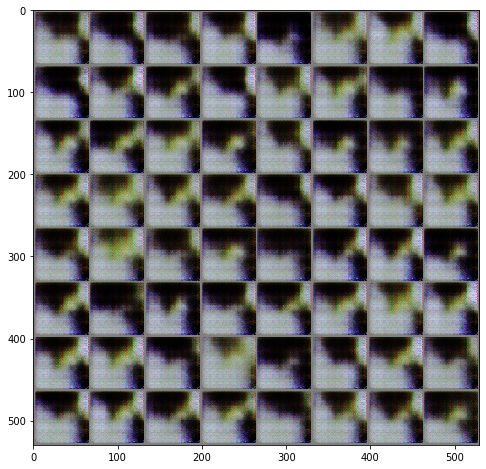

Epoch 30
Current Discriminator Accuracy = 60.92857142857143
Current Discriminator Positives Accuracy = 57.857142857142854
Current Discriminator Negatives Accuracy = 64.0
Current Generator Accuracy = 0.0
2.248565878186907 0.3178099798304694
Epoch 31
Current Discriminator Accuracy = 62.42857142857143
Current Discriminator Positives Accuracy = 60.857142857142854
Current Discriminator Negatives Accuracy = 64.0
Current Generator Accuracy = 0.0
2.1915441751480103 0.2682494989463261
Epoch 32
Current Discriminator Accuracy = 55.0
Current Discriminator Positives Accuracy = 47.0
Current Discriminator Negatives Accuracy = 63.0
Current Generator Accuracy = 1.0
2.3728749752044678 0.4243808388710022
Epoch 33
Current Discriminator Accuracy = 53.64285714285714
Current Discriminator Positives Accuracy = 47.57142857142857
Current Discriminator Negatives Accuracy = 59.714285714285715
Current Generator Accuracy = 4.285714285714286
1.4696698955127172 0.6167933004243034
Epoch 34
Current Discriminator Accura

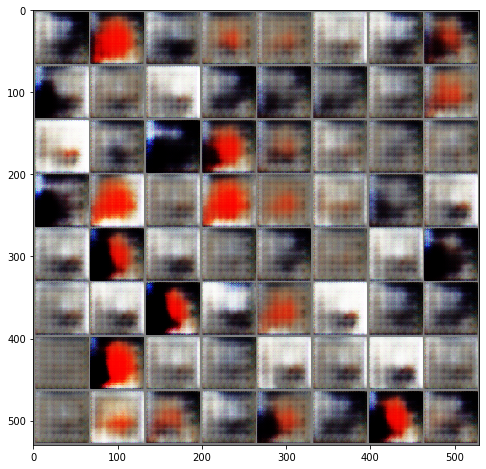

Epoch 40
Current Discriminator Accuracy = 50.92857142857143
Current Discriminator Positives Accuracy = 47.285714285714285
Current Discriminator Negatives Accuracy = 54.57142857142857
Current Generator Accuracy = 9.428571428571429
1.4514421139444624 0.597573595387595
Epoch 41
Current Discriminator Accuracy = 53.64285714285714
Current Discriminator Positives Accuracy = 44.42857142857143
Current Discriminator Negatives Accuracy = 62.857142857142854
Current Generator Accuracy = 1.1428571428571428
1.2263044374329704 0.591529871736254
Epoch 42
Current Discriminator Accuracy = 50.0
Current Discriminator Positives Accuracy = 46.857142857142854
Current Discriminator Negatives Accuracy = 53.142857142857146
Current Generator Accuracy = 10.857142857142858
1.0917571016720362 0.6056258508137294
Epoch 43
Current Discriminator Accuracy = 49.5
Current Discriminator Positives Accuracy = 40.285714285714285
Current Discriminator Negatives Accuracy = 58.714285714285715
Current Generator Accuracy = 5.285714

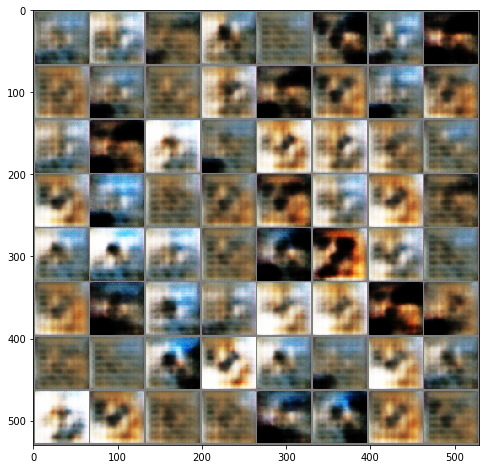

Epoch 50
Current Discriminator Accuracy = 40.92857142857143
Current Discriminator Positives Accuracy = 35.42857142857143
Current Discriminator Negatives Accuracy = 46.42857142857143
Current Generator Accuracy = 17.571428571428573
1.0534435638359614 0.6957138351031712
Epoch 51
Current Discriminator Accuracy = 45.71428571428571
Current Discriminator Positives Accuracy = 41.57142857142857
Current Discriminator Negatives Accuracy = 49.857142857142854
Current Generator Accuracy = 14.142857142857142
1.0024138518742152 0.6852205736296517
Epoch 52
Current Discriminator Accuracy = 48.0
Current Discriminator Positives Accuracy = 45.857142857142854
Current Discriminator Negatives Accuracy = 50.142857142857146
Current Generator Accuracy = 13.857142857142858
0.9916100416864667 0.6450528502464294
Epoch 53
Current Discriminator Accuracy = 56.214285714285715
Current Discriminator Positives Accuracy = 52.0
Current Discriminator Negatives Accuracy = 60.42857142857143
Current Generator Accuracy = 3.57142

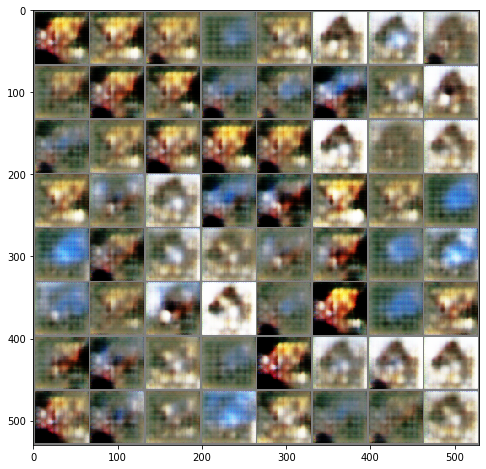

Epoch 60
Current Discriminator Accuracy = 46.07142857142857
Current Discriminator Positives Accuracy = 40.714285714285715
Current Discriminator Negatives Accuracy = 51.42857142857143
Current Generator Accuracy = 12.571428571428571
1.244170538016728 0.6501016020774841
Epoch 61
Current Discriminator Accuracy = 53.35714285714286
Current Discriminator Positives Accuracy = 46.142857142857146
Current Discriminator Negatives Accuracy = 60.57142857142857
Current Generator Accuracy = 3.4285714285714284
1.047835179737636 0.6005491954939706
Epoch 62
Current Discriminator Accuracy = 52.35714285714286
Current Discriminator Positives Accuracy = 47.285714285714285
Current Discriminator Negatives Accuracy = 57.42857142857143
Current Generator Accuracy = 6.571428571428571
1.3381542989185877 0.5905390466962542
Epoch 63
Current Discriminator Accuracy = 57.57142857142857
Current Discriminator Positives Accuracy = 55.42857142857143
Current Discriminator Negatives Accuracy = 59.714285714285715
Current Gener

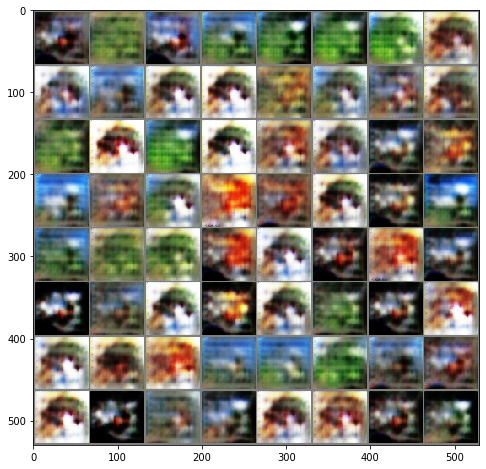

Epoch 70
Current Discriminator Accuracy = 51.142857142857146
Current Discriminator Positives Accuracy = 46.142857142857146
Current Discriminator Negatives Accuracy = 56.142857142857146
Current Generator Accuracy = 7.857142857142857
1.1683952808380127 0.5749108067580632
Epoch 71
Current Discriminator Accuracy = 61.785714285714285
Current Discriminator Positives Accuracy = 59.57142857142857
Current Discriminator Negatives Accuracy = 64.0
Current Generator Accuracy = 0.0
1.5975417409624373 0.3676110420908247
Epoch 72
Current Discriminator Accuracy = 63.14285714285714
Current Discriminator Positives Accuracy = 63.0
Current Discriminator Negatives Accuracy = 63.285714285714285
Current Generator Accuracy = 0.7142857142857143
1.699878113610404 0.2917751009975161
Epoch 73
Current Discriminator Accuracy = 55.14285714285714
Current Discriminator Positives Accuracy = 50.57142857142857
Current Discriminator Negatives Accuracy = 59.714285714285715
Current Generator Accuracy = 4.285714285714286
2.19

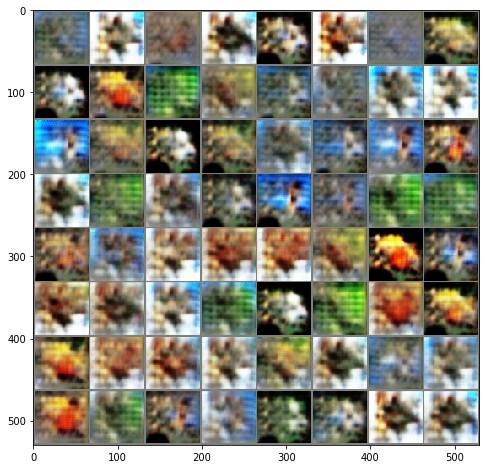

Epoch 80
Current Discriminator Accuracy = 63.57142857142857
Current Discriminator Positives Accuracy = 63.142857142857146
Current Discriminator Negatives Accuracy = 64.0
Current Generator Accuracy = 0.0
2.3572526829583302 0.24981605580874852
Epoch 81
Current Discriminator Accuracy = 57.92857142857143
Current Discriminator Positives Accuracy = 53.42857142857143
Current Discriminator Negatives Accuracy = 62.42857142857143
Current Generator Accuracy = 1.5714285714285714
2.428369845662798 0.2846258836133139
Epoch 82
Current Discriminator Accuracy = 50.642857142857146
Current Discriminator Positives Accuracy = 47.142857142857146
Current Discriminator Negatives Accuracy = 54.142857142857146
Current Generator Accuracy = 9.857142857142858
1.5858064208711897 0.49213787061827524
Epoch 83
Current Discriminator Accuracy = 44.5
Current Discriminator Positives Accuracy = 37.57142857142857
Current Discriminator Negatives Accuracy = 51.42857142857143
Current Generator Accuracy = 12.571428571428571
1.5

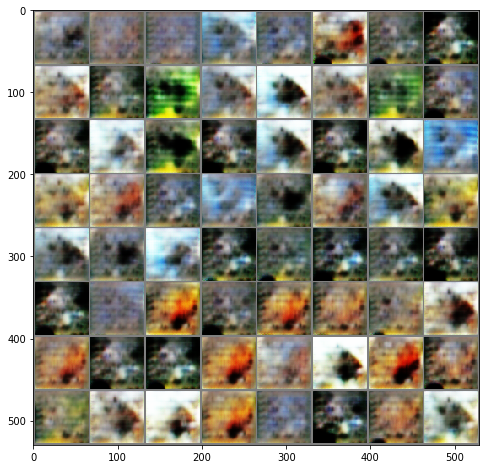

Epoch 90
Current Discriminator Accuracy = 59.785714285714285
Current Discriminator Positives Accuracy = 55.57142857142857
Current Discriminator Negatives Accuracy = 64.0
Current Generator Accuracy = 0.0
1.6623884439468384 0.4379898373569761
Epoch 91
Current Discriminator Accuracy = 49.57142857142857
Current Discriminator Positives Accuracy = 38.714285714285715
Current Discriminator Negatives Accuracy = 60.42857142857143
Current Generator Accuracy = 3.5714285714285716
1.605362858091082 0.5243229099682399
Epoch 92
Current Discriminator Accuracy = 59.57142857142857
Current Discriminator Positives Accuracy = 60.57142857142857
Current Discriminator Negatives Accuracy = 58.57142857142857
Current Generator Accuracy = 5.428571428571429
1.4766393218721663 0.44159504558358875
Epoch 93
Current Discriminator Accuracy = 54.142857142857146
Current Discriminator Positives Accuracy = 45.142857142857146
Current Discriminator Negatives Accuracy = 63.142857142857146
Current Generator Accuracy = 0.8571428

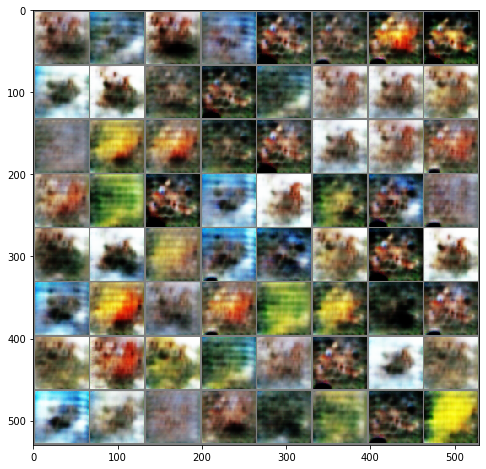

Epoch 100
Current Discriminator Accuracy = 50.5
Current Discriminator Positives Accuracy = 49.0
Current Discriminator Negatives Accuracy = 52.0
Current Generator Accuracy = 12.0
1.164439754826682 0.5103113438401904
Epoch 101
Current Discriminator Accuracy = 51.42857142857143
Current Discriminator Positives Accuracy = 45.142857142857146
Current Discriminator Negatives Accuracy = 57.714285714285715
Current Generator Accuracy = 6.285714285714286
1.272558833871569 0.5860398752348763
Epoch 102
Current Discriminator Accuracy = 57.57142857142857
Current Discriminator Positives Accuracy = 58.57142857142857
Current Discriminator Negatives Accuracy = 56.57142857142857
Current Generator Accuracy = 7.428571428571429
1.5883665340287345 0.37693996940340313
Epoch 103
Current Discriminator Accuracy = 61.57142857142857
Current Discriminator Positives Accuracy = 64.0
Current Discriminator Negatives Accuracy = 59.142857142857146
Current Generator Accuracy = 4.857142857142857
2.2621617913246155 0.24650196

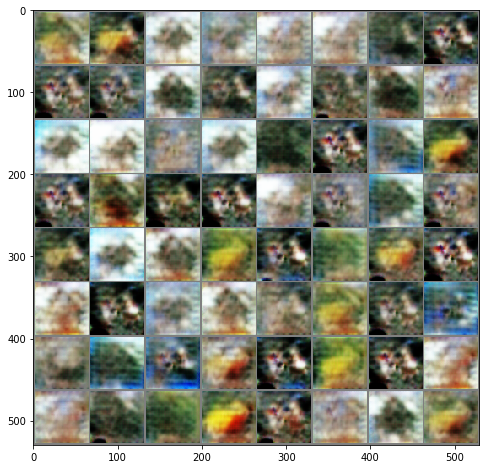

Epoch 110
Current Discriminator Accuracy = 57.42857142857143
Current Discriminator Positives Accuracy = 51.57142857142857
Current Discriminator Negatives Accuracy = 63.285714285714285
Current Generator Accuracy = 0.7142857142857143
1.837746500968933 0.4609033167362213
Epoch 111
Current Discriminator Accuracy = 37.64285714285714
Current Discriminator Positives Accuracy = 35.0
Current Discriminator Negatives Accuracy = 40.285714285714285
Current Generator Accuracy = 23.714285714285715
0.9494518211909703 0.7462770427976336
Epoch 112
Current Discriminator Accuracy = 52.35714285714286
Current Discriminator Positives Accuracy = 43.42857142857143
Current Discriminator Negatives Accuracy = 61.285714285714285
Current Generator Accuracy = 2.7142857142857144
1.2288054653576441 0.6064593664237431
Epoch 113
Current Discriminator Accuracy = 49.35714285714286
Current Discriminator Positives Accuracy = 46.57142857142857
Current Discriminator Negatives Accuracy = 52.142857142857146
Current Generator Ac

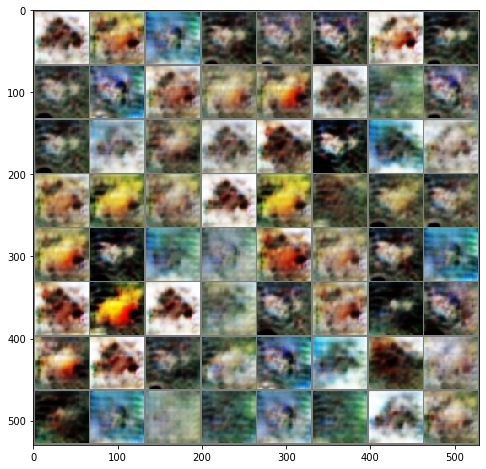

Epoch 120
Current Discriminator Accuracy = 37.714285714285715
Current Discriminator Positives Accuracy = 33.0
Current Discriminator Negatives Accuracy = 42.42857142857143
Current Generator Accuracy = 21.571428571428573
0.7617249914578029 0.7307342035429818
Epoch 121
Current Discriminator Accuracy = 45.07142857142857
Current Discriminator Positives Accuracy = 43.42857142857143
Current Discriminator Negatives Accuracy = 46.714285714285715
Current Generator Accuracy = 17.285714285714285
0.8159915719713483 0.6578690707683563
Epoch 122
Current Discriminator Accuracy = 45.285714285714285
Current Discriminator Positives Accuracy = 38.714285714285715
Current Discriminator Negatives Accuracy = 51.857142857142854
Current Generator Accuracy = 12.142857142857142
0.8732588120869228 0.6677542158535549
Epoch 123
Current Discriminator Accuracy = 46.64285714285714
Current Discriminator Positives Accuracy = 40.285714285714285
Current Discriminator Negatives Accuracy = 53.0
Current Generator Accuracy = 1

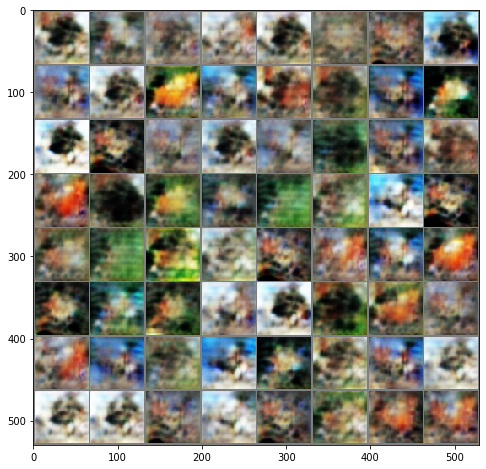

Epoch 130
Current Discriminator Accuracy = 43.714285714285715
Current Discriminator Positives Accuracy = 46.142857142857146
Current Discriminator Negatives Accuracy = 41.285714285714285
Current Generator Accuracy = 22.714285714285715
0.785865238734654 0.6591997572353908
Epoch 131
Current Discriminator Accuracy = 43.07142857142857
Current Discriminator Positives Accuracy = 40.57142857142857
Current Discriminator Negatives Accuracy = 45.57142857142857
Current Generator Accuracy = 18.428571428571427
0.8285680498395648 0.678184517792293
Epoch 132
Current Discriminator Accuracy = 35.785714285714285
Current Discriminator Positives Accuracy = 30.142857142857142
Current Discriminator Negatives Accuracy = 41.42857142857143
Current Generator Accuracy = 22.571428571428573
0.8063974465642657 0.7040802580969674
Epoch 133
Current Discriminator Accuracy = 36.35714285714286
Current Discriminator Positives Accuracy = 28.571428571428573
Current Discriminator Negatives Accuracy = 44.142857142857146
Curre

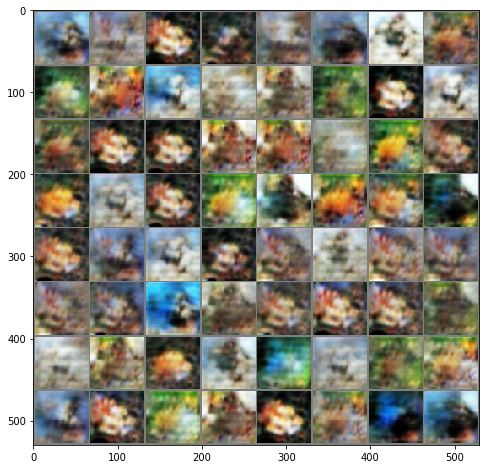

Epoch 140
Current Discriminator Accuracy = 26.714285714285715
Current Discriminator Positives Accuracy = 22.142857142857142
Current Discriminator Negatives Accuracy = 31.285714285714285
Current Generator Accuracy = 32.714285714285715
0.6946521912302289 0.7656479222433907
Epoch 141
Current Discriminator Accuracy = 29.285714285714285
Current Discriminator Positives Accuracy = 24.428571428571427
Current Discriminator Negatives Accuracy = 34.142857142857146
Current Generator Accuracy = 29.857142857142858
0.7156995620046344 0.7532716819218227
Epoch 142
Current Discriminator Accuracy = 31.928571428571427
Current Discriminator Positives Accuracy = 29.285714285714285
Current Discriminator Negatives Accuracy = 34.57142857142857
Current Generator Accuracy = 29.428571428571427
0.7236126746450152 0.7309250065258571
Epoch 143
Current Discriminator Accuracy = 28.785714285714285
Current Discriminator Positives Accuracy = 24.428571428571427
Current Discriminator Negatives Accuracy = 33.142857142857146

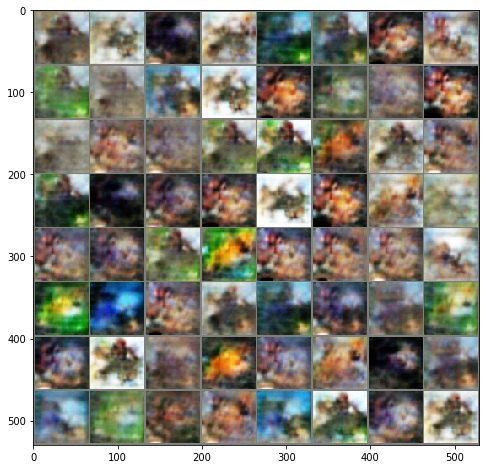

Epoch 150
Current Discriminator Accuracy = 22.642857142857146
Current Discriminator Positives Accuracy = 20.714285714285715
Current Discriminator Negatives Accuracy = 24.571428571428573
Current Generator Accuracy = 39.42857142857143
0.6698264735085624 0.7620144827025277
Epoch 151
Current Discriminator Accuracy = 22.142857142857146
Current Discriminator Positives Accuracy = 17.714285714285715
Current Discriminator Negatives Accuracy = 26.571428571428573
Current Generator Accuracy = 37.42857142857143
0.6774493030139378 0.767566476549421
Epoch 152
Current Discriminator Accuracy = 15.714285714285715
Current Discriminator Positives Accuracy = 16.857142857142858
Current Discriminator Negatives Accuracy = 14.571428571428571
Current Generator Accuracy = 49.42857142857143
0.6320110900061471 0.8002959149224418
Epoch 153
Current Discriminator Accuracy = 18.5
Current Discriminator Positives Accuracy = 15.714285714285714
Current Discriminator Negatives Accuracy = 21.285714285714285
Current Generato

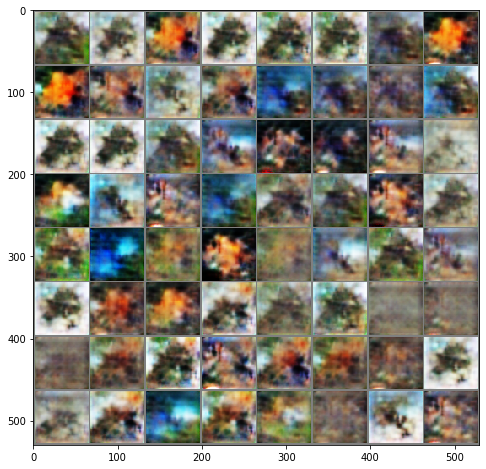

Epoch 160
Current Discriminator Accuracy = 20.642857142857142
Current Discriminator Positives Accuracy = 16.285714285714285
Current Discriminator Negatives Accuracy = 25.0
Current Generator Accuracy = 39.0
0.6711508546556745 0.7668166671480451
Epoch 161
Current Discriminator Accuracy = 18.642857142857142
Current Discriminator Positives Accuracy = 19.428571428571427
Current Discriminator Negatives Accuracy = 17.857142857142858
Current Generator Accuracy = 46.142857142857146
0.652778012411935 0.7716715165546962
Epoch 162
Current Discriminator Accuracy = 21.92857142857143
Current Discriminator Positives Accuracy = 20.285714285714285
Current Discriminator Negatives Accuracy = 23.571428571428573
Current Generator Accuracy = 40.42857142857143
0.6712120856557574 0.7599613325936454
Epoch 163
Current Discriminator Accuracy = 19.07142857142857
Current Discriminator Positives Accuracy = 17.0
Current Discriminator Negatives Accuracy = 21.142857142857142
Current Generator Accuracy = 42.857142857142

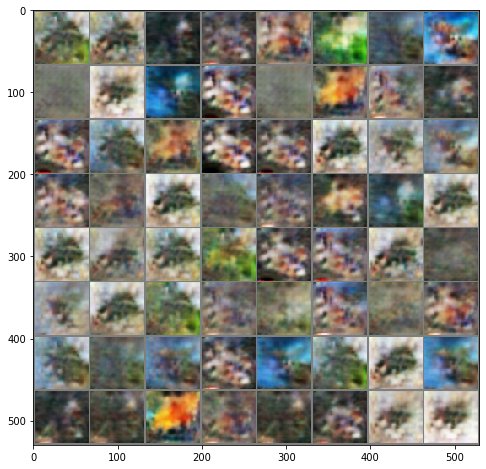

Epoch 170
Current Discriminator Accuracy = 17.285714285714285
Current Discriminator Positives Accuracy = 16.714285714285715
Current Discriminator Negatives Accuracy = 17.857142857142858
Current Generator Accuracy = 46.142857142857146
0.6557008624076843 0.7586502773421151
Epoch 171
Current Discriminator Accuracy = 15.928571428571429
Current Discriminator Positives Accuracy = 13.142857142857142
Current Discriminator Negatives Accuracy = 18.714285714285715
Current Generator Accuracy = 45.285714285714285
0.6509222643715995 0.7696905561855861
Epoch 172
Current Discriminator Accuracy = 16.571428571428573
Current Discriminator Positives Accuracy = 14.285714285714286
Current Discriminator Negatives Accuracy = 18.857142857142858
Current Generator Accuracy = 45.142857142857146
0.6598267299788338 0.7630265610558646
Epoch 173
Current Discriminator Accuracy = 15.785714285714285
Current Discriminator Positives Accuracy = 15.142857142857142
Current Discriminator Negatives Accuracy = 16.42857142857142

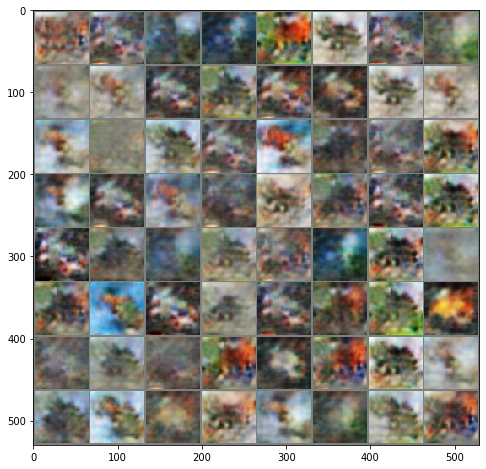

Epoch 180
Current Discriminator Accuracy = 16.071428571428573
Current Discriminator Positives Accuracy = 16.571428571428573
Current Discriminator Negatives Accuracy = 15.571428571428571
Current Generator Accuracy = 48.42857142857143
0.6530551399503436 0.7609965120043073
Epoch 181
Current Discriminator Accuracy = 17.071428571428573
Current Discriminator Positives Accuracy = 13.571428571428571
Current Discriminator Negatives Accuracy = 20.571428571428573
Current Generator Accuracy = 43.42857142857143
0.6632510849407741 0.7562246918678284
Epoch 182
Current Discriminator Accuracy = 14.785714285714285
Current Discriminator Positives Accuracy = 15.714285714285714
Current Discriminator Negatives Accuracy = 13.857142857142858
Current Generator Accuracy = 50.142857142857146
0.6490400178091866 0.7589654667036874
Epoch 183
Current Discriminator Accuracy = 16.142857142857142
Current Discriminator Positives Accuracy = 15.571428571428571
Current Discriminator Negatives Accuracy = 16.714285714285715


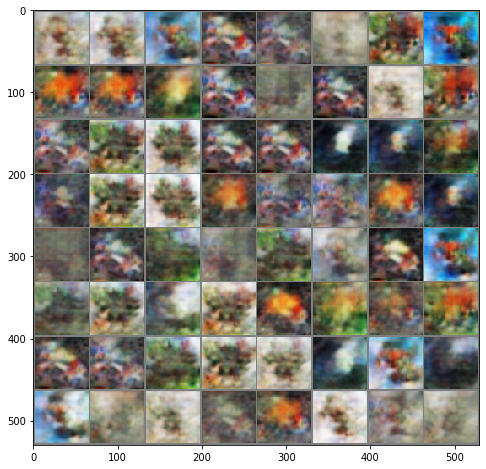

Epoch 190
Current Discriminator Accuracy = 17.92857142857143
Current Discriminator Positives Accuracy = 17.571428571428573
Current Discriminator Negatives Accuracy = 18.285714285714285
Current Generator Accuracy = 45.714285714285715
0.6653118899890355 0.7435398697853088
Epoch 191
Current Discriminator Accuracy = 14.928571428571427
Current Discriminator Positives Accuracy = 14.142857142857142
Current Discriminator Negatives Accuracy = 15.714285714285714
Current Generator Accuracy = 48.285714285714285
0.6581153358731952 0.7510893515178135
Epoch 192
Current Discriminator Accuracy = 14.571428571428573
Current Discriminator Positives Accuracy = 13.285714285714286
Current Discriminator Negatives Accuracy = 15.857142857142858
Current Generator Accuracy = 48.142857142857146
0.6606239676475525 0.7514503598213196
Epoch 193
Current Discriminator Accuracy = 18.142857142857142
Current Discriminator Positives Accuracy = 18.285714285714285
Current Discriminator Negatives Accuracy = 18.0
Current Gener

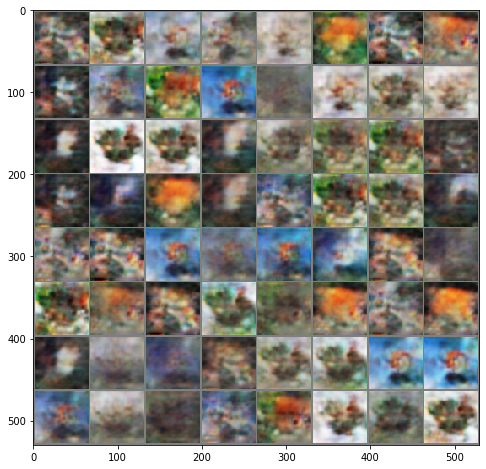

Epoch 200
Current Discriminator Accuracy = 13.928571428571429
Current Discriminator Positives Accuracy = 14.857142857142858
Current Discriminator Negatives Accuracy = 13.0
Current Generator Accuracy = 51.0
0.6532516309193203 0.746258190699986
Epoch 201
Current Discriminator Accuracy = 14.571428571428573
Current Discriminator Positives Accuracy = 16.714285714285715
Current Discriminator Negatives Accuracy = 12.428571428571429
Current Generator Accuracy = 51.57142857142857
0.6539193221500942 0.7418908136231559
Epoch 202
Current Discriminator Accuracy = 15.928571428571427
Current Discriminator Positives Accuracy = 14.714285714285714
Current Discriminator Negatives Accuracy = 17.142857142857142
Current Generator Accuracy = 46.857142857142854
0.664904500756945 0.7406261903899056
Epoch 203
Current Discriminator Accuracy = 14.857142857142858
Current Discriminator Positives Accuracy = 13.571428571428571
Current Discriminator Negatives Accuracy = 16.142857142857142
Current Generator Accuracy = 

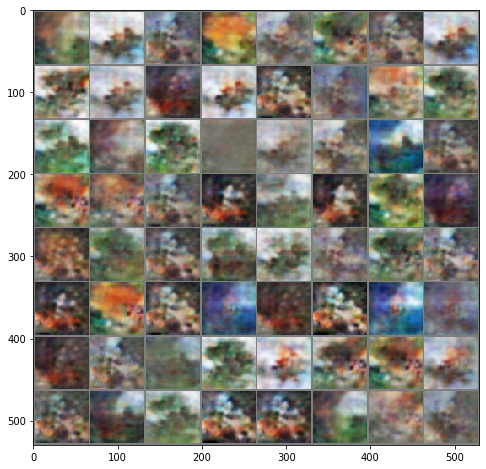

Epoch 210
Current Discriminator Accuracy = 19.57142857142857
Current Discriminator Positives Accuracy = 17.714285714285715
Current Discriminator Negatives Accuracy = 21.428571428571427
Current Generator Accuracy = 42.57142857142857
0.6749358177185059 0.729472645691463
Epoch 211
Current Discriminator Accuracy = 21.0
Current Discriminator Positives Accuracy = 21.142857142857142
Current Discriminator Negatives Accuracy = 20.857142857142858
Current Generator Accuracy = 43.142857142857146
0.6723362973758152 0.7277134997504098
Epoch 212
Current Discriminator Accuracy = 17.07142857142857
Current Discriminator Positives Accuracy = 19.0
Current Discriminator Negatives Accuracy = 15.142857142857142
Current Generator Accuracy = 48.857142857142854
0.6573575139045715 0.7360926781381879
Epoch 213
Current Discriminator Accuracy = 16.214285714285715
Current Discriminator Positives Accuracy = 17.714285714285715
Current Discriminator Negatives Accuracy = 14.714285714285714
Current Generator Accuracy = 4

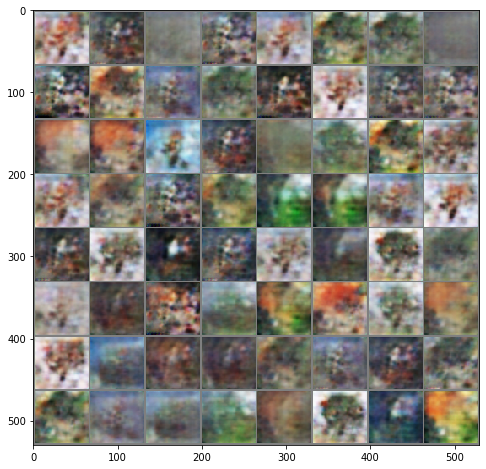

Epoch 220
Current Discriminator Accuracy = 16.357142857142858
Current Discriminator Positives Accuracy = 20.428571428571427
Current Discriminator Negatives Accuracy = 12.285714285714286
Current Generator Accuracy = 51.714285714285715
0.6630388924053737 0.7263654811041695
Epoch 221
Current Discriminator Accuracy = 14.071428571428573
Current Discriminator Positives Accuracy = 19.571428571428573
Current Discriminator Negatives Accuracy = 8.571428571428571
Current Generator Accuracy = 55.42857142857143
0.6522461346217564 0.7336520552635193
Epoch 222
Current Discriminator Accuracy = 14.571428571428571
Current Discriminator Positives Accuracy = 18.285714285714285
Current Discriminator Negatives Accuracy = 10.857142857142858
Current Generator Accuracy = 53.142857142857146
0.6570054377828326 0.7313317656517029
Epoch 223
Current Discriminator Accuracy = 17.5
Current Discriminator Positives Accuracy = 18.142857142857142
Current Discriminator Negatives Accuracy = 16.857142857142858
Current Genera

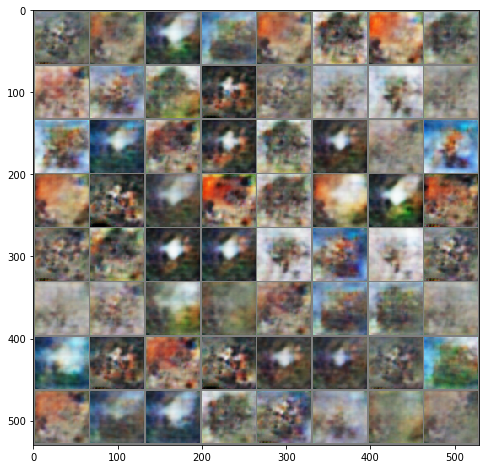

Epoch 230
Current Discriminator Accuracy = 18.857142857142854
Current Discriminator Positives Accuracy = 18.285714285714285
Current Discriminator Negatives Accuracy = 19.428571428571427
Current Generator Accuracy = 44.57142857142857
0.6731710263660976 0.7225010054452079
Epoch 231
Current Discriminator Accuracy = 15.642857142857142
Current Discriminator Positives Accuracy = 16.857142857142858
Current Discriminator Negatives Accuracy = 14.428571428571429
Current Generator Accuracy = 49.57142857142857
0.6665025268282209 0.7278123327663967
Epoch 232
Current Discriminator Accuracy = 16.785714285714285
Current Discriminator Positives Accuracy = 17.142857142857142
Current Discriminator Negatives Accuracy = 16.428571428571427
Current Generator Accuracy = 47.57142857142857
0.6715862580708095 0.7226781504494804
Epoch 233
Current Discriminator Accuracy = 16.714285714285715
Current Discriminator Positives Accuracy = 17.714285714285715
Current Discriminator Negatives Accuracy = 15.714285714285714
C

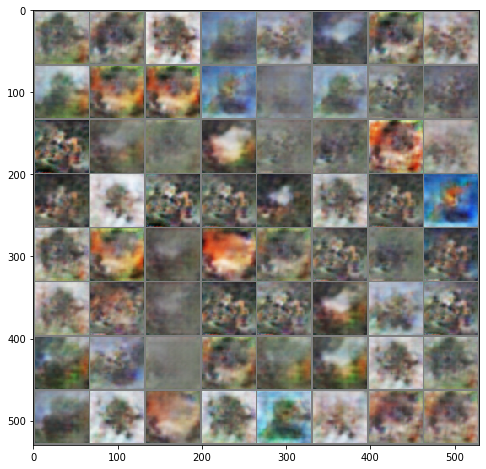

Epoch 240
Current Discriminator Accuracy = 16.5
Current Discriminator Positives Accuracy = 19.142857142857142
Current Discriminator Negatives Accuracy = 13.857142857142858
Current Generator Accuracy = 50.142857142857146
0.6663761990410941 0.7217175705092294
Epoch 241
Current Discriminator Accuracy = 16.285714285714285
Current Discriminator Positives Accuracy = 17.571428571428573
Current Discriminator Negatives Accuracy = 15.0
Current Generator Accuracy = 49.0
0.6728494678224836 0.7200884478432792
Epoch 242
Current Discriminator Accuracy = 17.42857142857143
Current Discriminator Positives Accuracy = 19.857142857142858
Current Discriminator Negatives Accuracy = 15.0
Current Generator Accuracy = 49.0
0.6698705809456962 0.7210763352257865
Epoch 243
Current Discriminator Accuracy = 14.357142857142858
Current Discriminator Positives Accuracy = 14.428571428571429
Current Discriminator Negatives Accuracy = 14.285714285714286
Current Generator Accuracy = 49.714285714285715
0.6714791910988944 0.

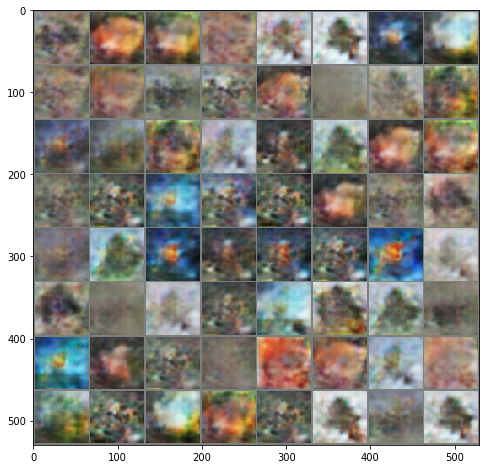

Epoch 250
Current Discriminator Accuracy = 14.428571428571429
Current Discriminator Positives Accuracy = 20.714285714285715
Current Discriminator Negatives Accuracy = 8.142857142857142
Current Generator Accuracy = 55.857142857142854
0.6633815084184919 0.719904899597168
Epoch 251
Current Discriminator Accuracy = 16.214285714285715
Current Discriminator Positives Accuracy = 18.714285714285715
Current Discriminator Negatives Accuracy = 13.714285714285714
Current Generator Accuracy = 50.285714285714285
0.6685003978865487 0.7217334508895874
Epoch 252
Current Discriminator Accuracy = 14.642857142857142
Current Discriminator Positives Accuracy = 14.714285714285714
Current Discriminator Negatives Accuracy = 14.571428571428571
Current Generator Accuracy = 49.42857142857143
0.6731730273791722 0.7218198009899685
Epoch 253
Current Discriminator Accuracy = 15.142857142857142
Current Discriminator Positives Accuracy = 17.428571428571427
Current Discriminator Negatives Accuracy = 12.857142857142858
C

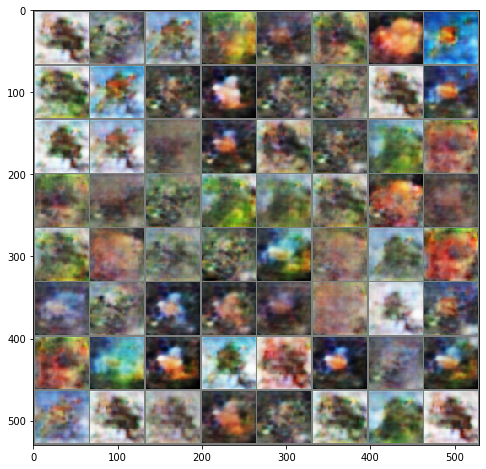

Epoch 260
Current Discriminator Accuracy = 15.071428571428571
Current Discriminator Positives Accuracy = 15.571428571428571
Current Discriminator Negatives Accuracy = 14.571428571428571
Current Generator Accuracy = 49.42857142857143
0.6742086751120431 0.7174807190895081
Epoch 261
Current Discriminator Accuracy = 15.928571428571429
Current Discriminator Positives Accuracy = 13.0
Current Discriminator Negatives Accuracy = 18.857142857142858
Current Generator Accuracy = 45.142857142857146
0.6800879325185504 0.7158470835004535
Epoch 262
Current Discriminator Accuracy = 14.0
Current Discriminator Positives Accuracy = 12.285714285714286
Current Discriminator Negatives Accuracy = 15.714285714285714
Current Generator Accuracy = 48.285714285714285
0.6737138032913208 0.7196223310061863
Epoch 263
Current Discriminator Accuracy = 15.857142857142858
Current Discriminator Positives Accuracy = 12.142857142857142
Current Discriminator Negatives Accuracy = 19.571428571428573
Current Generator Accuracy 

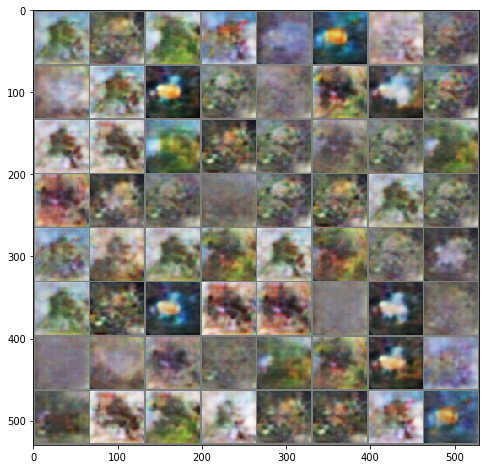

Epoch 270
Current Discriminator Accuracy = 14.214285714285714
Current Discriminator Positives Accuracy = 13.714285714285714
Current Discriminator Negatives Accuracy = 14.714285714285714
Current Generator Accuracy = 49.285714285714285
0.6761139971869332 0.7144590701375689
Epoch 271
Current Discriminator Accuracy = 15.642857142857142
Current Discriminator Positives Accuracy = 14.0
Current Discriminator Negatives Accuracy = 17.285714285714285
Current Generator Accuracy = 46.714285714285715
0.6801270757402692 0.7129324163709369
Epoch 272
Current Discriminator Accuracy = 15.42857142857143
Current Discriminator Positives Accuracy = 14.285714285714286
Current Discriminator Negatives Accuracy = 16.571428571428573
Current Generator Accuracy = 47.42857142857143
0.6769822580473763 0.7140278390475682
Epoch 273
Current Discriminator Accuracy = 15.785714285714285
Current Discriminator Positives Accuracy = 12.571428571428571
Current Discriminator Negatives Accuracy = 19.0
Current Generator Accuracy =

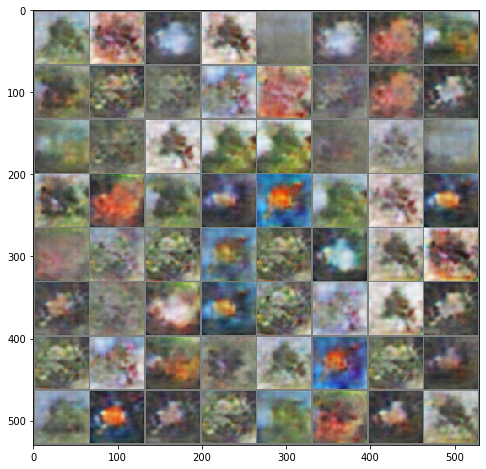

Epoch 280
Current Discriminator Accuracy = 14.714285714285715
Current Discriminator Positives Accuracy = 16.857142857142858
Current Discriminator Negatives Accuracy = 12.571428571428571
Current Generator Accuracy = 51.42857142857143
0.6768440859658378 0.7108116405350822
Epoch 281
Current Discriminator Accuracy = 13.428571428571427
Current Discriminator Positives Accuracy = 17.428571428571427
Current Discriminator Negatives Accuracy = 9.428571428571429
Current Generator Accuracy = 54.57142857142857
0.6747187461171832 0.710161030292511
Epoch 282
Current Discriminator Accuracy = 14.928571428571429
Current Discriminator Positives Accuracy = 14.428571428571429
Current Discriminator Negatives Accuracy = 15.428571428571429
Current Generator Accuracy = 48.57142857142857
0.681981486933572 0.7082362685884748
Epoch 283
Current Discriminator Accuracy = 13.214285714285714
Current Discriminator Positives Accuracy = 10.714285714285714
Current Discriminator Negatives Accuracy = 15.714285714285714
Curr

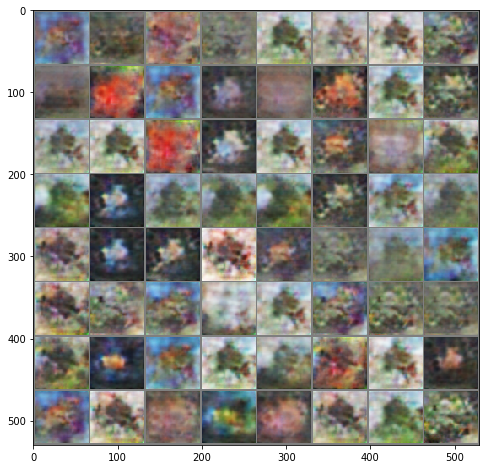

Epoch 290
Current Discriminator Accuracy = 13.142857142857142
Current Discriminator Positives Accuracy = 19.857142857142858
Current Discriminator Negatives Accuracy = 6.428571428571429
Current Generator Accuracy = 57.57142857142857
0.6775552800723484 0.706970580986568
Epoch 291
Current Discriminator Accuracy = 13.928571428571429
Current Discriminator Positives Accuracy = 20.0
Current Discriminator Negatives Accuracy = 7.857142857142857
Current Generator Accuracy = 56.142857142857146
0.6778433237757001 0.7058781726019723
Epoch 292
Current Discriminator Accuracy = 15.285714285714285
Current Discriminator Positives Accuracy = 19.0
Current Discriminator Negatives Accuracy = 11.571428571428571
Current Generator Accuracy = 52.42857142857143
0.6790400147438049 0.7056448459625244
Epoch 293
Current Discriminator Accuracy = 13.928571428571429
Current Discriminator Positives Accuracy = 17.857142857142858
Current Discriminator Negatives Accuracy = 10.0
Current Generator Accuracy = 54.0
0.679170089

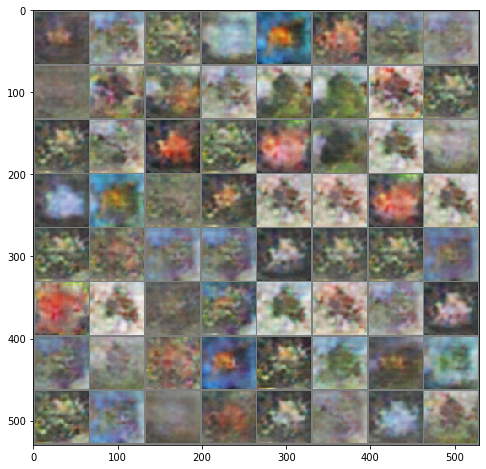

Epoch 300
Current Discriminator Accuracy = 15.285714285714285
Current Discriminator Positives Accuracy = 18.857142857142858
Current Discriminator Negatives Accuracy = 11.714285714285714
Current Generator Accuracy = 52.285714285714285
0.6816769668034145 0.7039462838854108
Epoch 301
Current Discriminator Accuracy = 14.857142857142858
Current Discriminator Positives Accuracy = 18.428571428571427
Current Discriminator Negatives Accuracy = 11.285714285714286
Current Generator Accuracy = 52.714285714285715
0.6821998868669782 0.7035072701317924
Epoch 302
Current Discriminator Accuracy = 13.5
Current Discriminator Positives Accuracy = 11.142857142857142
Current Discriminator Negatives Accuracy = 15.857142857142858
Current Generator Accuracy = 48.142857142857146
0.6860586745398385 0.7033388018608093
Epoch 303
Current Discriminator Accuracy = 14.0
Current Discriminator Positives Accuracy = 22.0
Current Discriminator Negatives Accuracy = 6.0
Current Generator Accuracy = 58.0
0.6806546790259225 0.

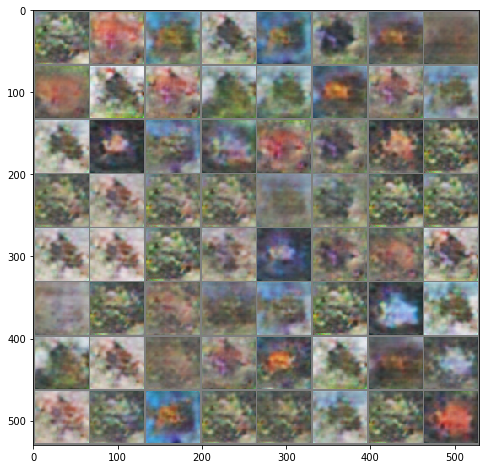

Epoch 310
Current Discriminator Accuracy = 17.571428571428573
Current Discriminator Positives Accuracy = 11.428571428571429
Current Discriminator Negatives Accuracy = 23.714285714285715
Current Generator Accuracy = 40.285714285714285
0.6896838545799255 0.7020329577582223
Epoch 311
Current Discriminator Accuracy = 17.42857142857143
Current Discriminator Positives Accuracy = 16.285714285714285
Current Discriminator Negatives Accuracy = 18.571428571428573
Current Generator Accuracy = 45.42857142857143
0.6864345669746399 0.7021253364426749
Epoch 312
Current Discriminator Accuracy = 18.285714285714285
Current Discriminator Positives Accuracy = 25.714285714285715
Current Discriminator Negatives Accuracy = 10.857142857142858
Current Generator Accuracy = 53.142857142857146
0.681215933391026 0.7018147962433952
Epoch 313
Current Discriminator Accuracy = 17.714285714285715
Current Discriminator Positives Accuracy = 14.142857142857142
Current Discriminator Negatives Accuracy = 21.285714285714285
C

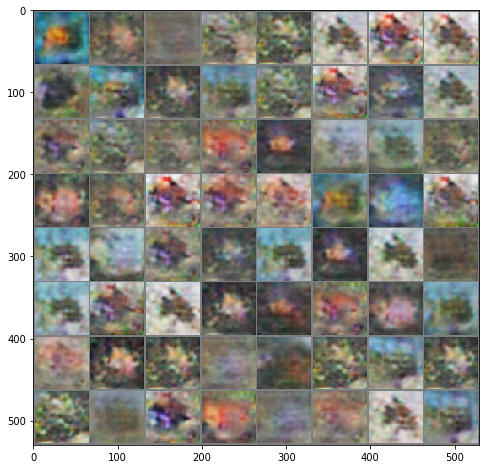

Epoch 320
Current Discriminator Accuracy = 19.642857142857142
Current Discriminator Positives Accuracy = 11.285714285714286
Current Discriminator Negatives Accuracy = 28.0
Current Generator Accuracy = 36.0
0.690619204725538 0.7005382350512913
Epoch 321
Current Discriminator Accuracy = 19.07142857142857
Current Discriminator Positives Accuracy = 11.142857142857142
Current Discriminator Negatives Accuracy = 27.0
Current Generator Accuracy = 37.0
0.6921008229255676 0.6997858711651394
Epoch 322
Current Discriminator Accuracy = 17.857142857142858
Current Discriminator Positives Accuracy = 30.714285714285715
Current Discriminator Negatives Accuracy = 5.0
Current Generator Accuracy = 59.0
0.67954592193876 0.700611276285989
Epoch 323
Current Discriminator Accuracy = 16.0
Current Discriminator Positives Accuracy = 17.857142857142858
Current Discriminator Negatives Accuracy = 14.142857142857142
Current Generator Accuracy = 49.857142857142854
0.6879198636327472 0.6994042822292873
Epoch 324
Curren

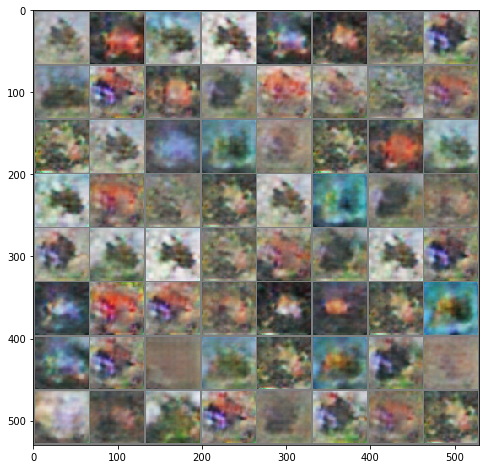

Epoch 330
Current Discriminator Accuracy = 17.142857142857142
Current Discriminator Positives Accuracy = 9.428571428571429
Current Discriminator Negatives Accuracy = 24.857142857142858
Current Generator Accuracy = 39.142857142857146
0.6912165454455784 0.7002153652054923
Epoch 331
Current Discriminator Accuracy = 23.142857142857142
Current Discriminator Positives Accuracy = 25.428571428571427
Current Discriminator Negatives Accuracy = 20.857142857142858
Current Generator Accuracy = 43.142857142857146
0.6885030950818744 0.6987694076129368
Epoch 332
Current Discriminator Accuracy = 19.42857142857143
Current Discriminator Positives Accuracy = 23.571428571428573
Current Discriminator Negatives Accuracy = 15.285714285714286
Current Generator Accuracy = 48.714285714285715
0.6879552432468959 0.698344349861145
Epoch 333
Current Discriminator Accuracy = 22.57142857142857
Current Discriminator Positives Accuracy = 19.0
Current Discriminator Negatives Accuracy = 26.142857142857142
Current Generato

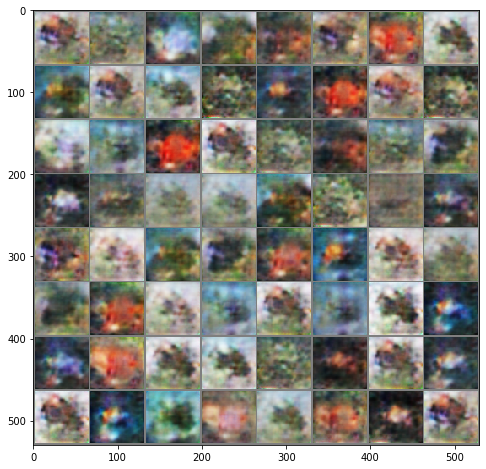

Epoch 340
Current Discriminator Accuracy = 24.214285714285715
Current Discriminator Positives Accuracy = 17.857142857142858
Current Discriminator Negatives Accuracy = 30.571428571428573
Current Generator Accuracy = 33.42857142857143
0.6925123674528939 0.7027646558625358
Epoch 341
Current Discriminator Accuracy = 32.714285714285715
Current Discriminator Positives Accuracy = 33.142857142857146
Current Discriminator Negatives Accuracy = 32.285714285714285
Current Generator Accuracy = 31.714285714285715
0.6925492627280099 0.6950319324220929
Epoch 342
Current Discriminator Accuracy = 25.214285714285715
Current Discriminator Positives Accuracy = 27.285714285714285
Current Discriminator Negatives Accuracy = 23.142857142857142
Current Generator Accuracy = 40.857142857142854
0.6846188051359994 0.7027367353439331
Epoch 343
Current Discriminator Accuracy = 32.785714285714285
Current Discriminator Positives Accuracy = 33.0
Current Discriminator Negatives Accuracy = 32.57142857142857
Current Genera

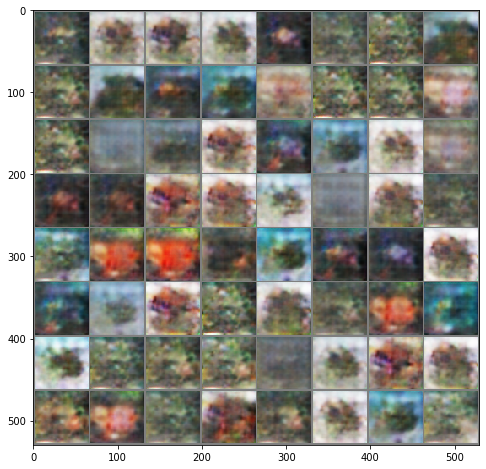

Epoch 350
Current Discriminator Accuracy = 25.07142857142857
Current Discriminator Positives Accuracy = 26.0
Current Discriminator Negatives Accuracy = 24.142857142857142
Current Generator Accuracy = 39.857142857142854
0.6814629861286708 0.7057668226105827
Epoch 351
Current Discriminator Accuracy = 33.35714285714286
Current Discriminator Positives Accuracy = 24.714285714285715
Current Discriminator Negatives Accuracy = 42.0
Current Generator Accuracy = 22.0
0.7054894651685443 0.6977667212486267
Epoch 352
Current Discriminator Accuracy = 41.85714285714286
Current Discriminator Positives Accuracy = 36.42857142857143
Current Discriminator Negatives Accuracy = 47.285714285714285
Current Generator Accuracy = 16.714285714285715
0.7168305260794503 0.6838789497103009
Epoch 353
Current Discriminator Accuracy = 19.642857142857142
Current Discriminator Positives Accuracy = 13.142857142857142
Current Discriminator Negatives Accuracy = 26.142857142857142
Current Generator Accuracy = 37.857142857142

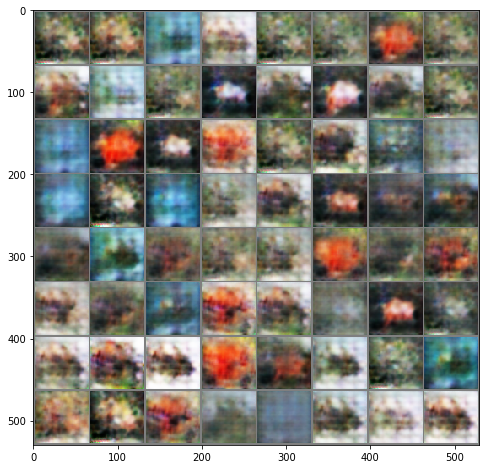

Epoch 360
Current Discriminator Accuracy = 20.357142857142858
Current Discriminator Positives Accuracy = 16.714285714285715
Current Discriminator Negatives Accuracy = 24.0
Current Generator Accuracy = 40.0
0.6882462501525879 0.7130471638270787
Epoch 361
Current Discriminator Accuracy = 40.57142857142857
Current Discriminator Positives Accuracy = 31.857142857142858
Current Discriminator Negatives Accuracy = 49.285714285714285
Current Generator Accuracy = 14.714285714285714
0.7167361123221261 0.6915546570505414
Epoch 362
Current Discriminator Accuracy = 41.14285714285714
Current Discriminator Positives Accuracy = 36.42857142857143
Current Discriminator Negatives Accuracy = 45.857142857142854
Current Generator Accuracy = 18.142857142857142
0.7231194972991943 0.6811956933566502
Epoch 363
Current Discriminator Accuracy = 34.57142857142857
Current Discriminator Positives Accuracy = 33.42857142857143
Current Discriminator Negatives Accuracy = 35.714285714285715
Current Generator Accuracy = 28

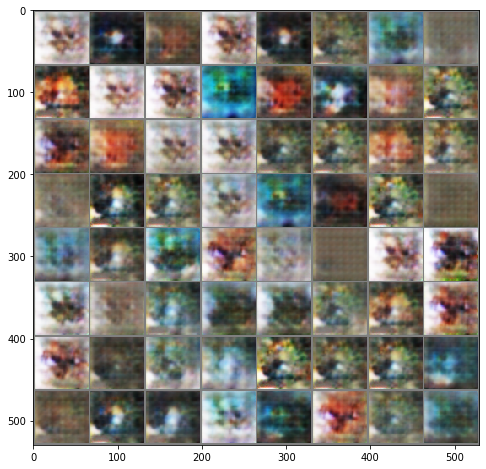

Epoch 370
Current Discriminator Accuracy = 34.142857142857146
Current Discriminator Positives Accuracy = 44.714285714285715
Current Discriminator Negatives Accuracy = 23.571428571428573
Current Generator Accuracy = 40.42857142857143
0.681752119745527 0.6945670247077942
Epoch 371
Current Discriminator Accuracy = 29.642857142857142
Current Discriminator Positives Accuracy = 44.857142857142854
Current Discriminator Negatives Accuracy = 14.428571428571429
Current Generator Accuracy = 49.57142857142857
0.6743250744683402 0.6992194482258388
Epoch 372
Current Discriminator Accuracy = 27.07142857142857
Current Discriminator Positives Accuracy = 37.0
Current Discriminator Negatives Accuracy = 17.142857142857142
Current Generator Accuracy = 46.857142857142854
0.6799232959747314 0.7029129351888385
Epoch 373
Current Discriminator Accuracy = 32.285714285714285
Current Discriminator Positives Accuracy = 34.285714285714285
Current Discriminator Negatives Accuracy = 30.285714285714285
Current Generato

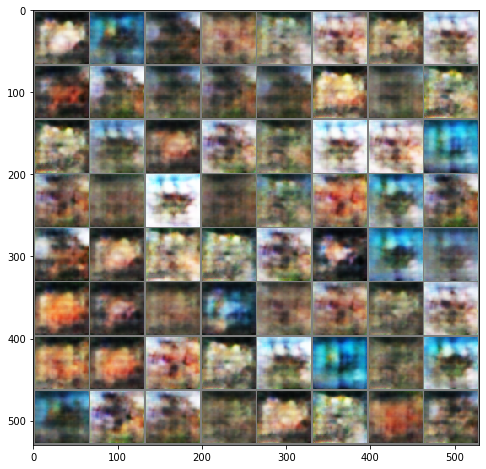

Epoch 380
Current Discriminator Accuracy = 31.57142857142857
Current Discriminator Positives Accuracy = 26.857142857142858
Current Discriminator Negatives Accuracy = 36.285714285714285
Current Generator Accuracy = 27.714285714285715
0.6981149400983538 0.6983680299350193
Epoch 381
Current Discriminator Accuracy = 31.57142857142857
Current Discriminator Positives Accuracy = 26.428571428571427
Current Discriminator Negatives Accuracy = 36.714285714285715
Current Generator Accuracy = 27.285714285714285
0.7052405646869114 0.6937260031700134
Epoch 382
Current Discriminator Accuracy = 32.285714285714285
Current Discriminator Positives Accuracy = 22.142857142857142
Current Discriminator Negatives Accuracy = 42.42857142857143
Current Generator Accuracy = 21.571428571428573
0.7077111601829529 0.693932729107993
Epoch 383
Current Discriminator Accuracy = 34.214285714285715
Current Discriminator Positives Accuracy = 29.571428571428573
Current Discriminator Negatives Accuracy = 38.857142857142854
Cu

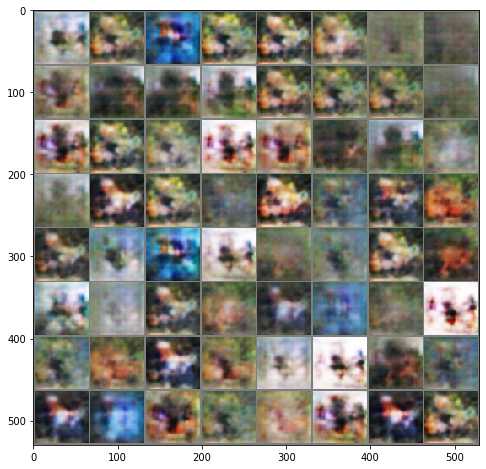

Epoch 390
Current Discriminator Accuracy = 31.142857142857146
Current Discriminator Positives Accuracy = 42.714285714285715
Current Discriminator Negatives Accuracy = 19.571428571428573
Current Generator Accuracy = 44.42857142857143
0.6826583402497428 0.6947347947529384
Epoch 391
Current Discriminator Accuracy = 31.5
Current Discriminator Positives Accuracy = 39.142857142857146
Current Discriminator Negatives Accuracy = 23.857142857142858
Current Generator Accuracy = 40.142857142857146
0.6875479987689427 0.6970242857933044
Epoch 392
Current Discriminator Accuracy = 32.07142857142857
Current Discriminator Positives Accuracy = 43.714285714285715
Current Discriminator Negatives Accuracy = 20.428571428571427
Current Generator Accuracy = 43.57142857142857
0.6856810024806431 0.6951081497328622
Epoch 393
Current Discriminator Accuracy = 31.57142857142857
Current Discriminator Positives Accuracy = 37.857142857142854
Current Discriminator Negatives Accuracy = 25.285714285714285
Current Generato

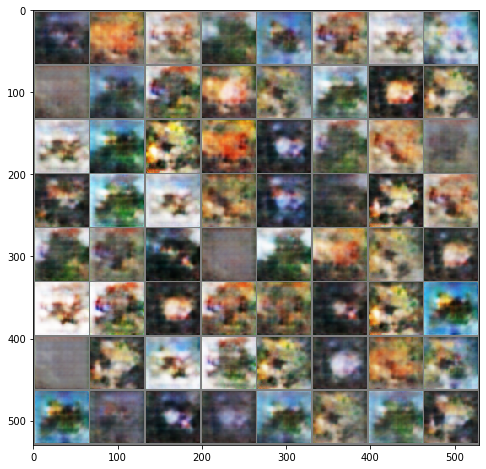

Epoch 400
Current Discriminator Accuracy = 30.07142857142857
Current Discriminator Positives Accuracy = 26.285714285714285
Current Discriminator Negatives Accuracy = 33.857142857142854
Current Generator Accuracy = 30.142857142857142
0.6965828623090472 0.6961777550833566
Epoch 401
Current Discriminator Accuracy = 24.92857142857143
Current Discriminator Positives Accuracy = 20.285714285714285
Current Discriminator Negatives Accuracy = 29.571428571428573
Current Generator Accuracy = 34.42857142857143
0.692657436643328 0.7012103710855756
Epoch 402
Current Discriminator Accuracy = 30.357142857142858
Current Discriminator Positives Accuracy = 14.714285714285714
Current Discriminator Negatives Accuracy = 46.0
Current Generator Accuracy = 18.0
0.701616610799517 0.7005951234272548
Epoch 403
Current Discriminator Accuracy = 32.214285714285715
Current Discriminator Positives Accuracy = 11.571428571428571
Current Discriminator Negatives Accuracy = 52.857142857142854
Current Generator Accuracy = 11

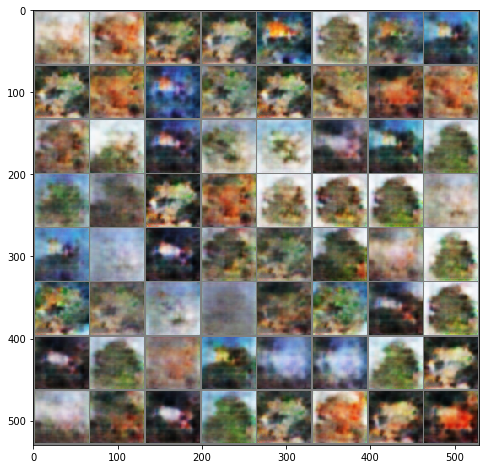

Epoch 410
Current Discriminator Accuracy = 31.0
Current Discriminator Positives Accuracy = 25.285714285714285
Current Discriminator Negatives Accuracy = 36.714285714285715
Current Generator Accuracy = 27.285714285714285
0.6948319843837193 0.69537695816585
Epoch 411
Current Discriminator Accuracy = 27.5
Current Discriminator Positives Accuracy = 15.571428571428571
Current Discriminator Negatives Accuracy = 39.42857142857143
Current Generator Accuracy = 24.571428571428573
0.7008785264832633 0.6974700859614781
Epoch 412
Current Discriminator Accuracy = 32.357142857142854
Current Discriminator Positives Accuracy = 30.142857142857142
Current Discriminator Negatives Accuracy = 34.57142857142857
Current Generator Accuracy = 29.428571428571427
0.6972692949431283 0.6948712723595756
Epoch 413
Current Discriminator Accuracy = 30.785714285714285
Current Discriminator Positives Accuracy = 29.571428571428573
Current Discriminator Negatives Accuracy = 32.0
Current Generator Accuracy = 32.0
0.69441418

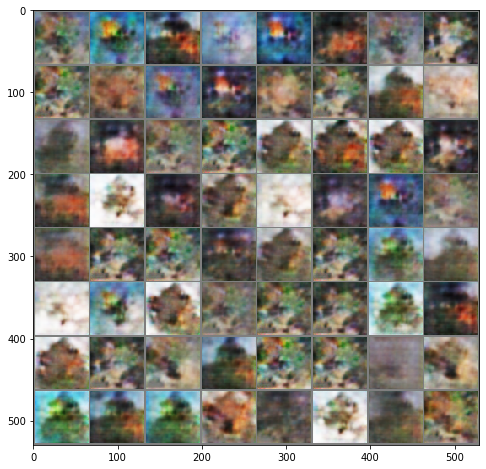

Epoch 420
Current Discriminator Accuracy = 28.428571428571427
Current Discriminator Positives Accuracy = 26.428571428571427
Current Discriminator Negatives Accuracy = 30.428571428571427
Current Generator Accuracy = 33.57142857142857
0.6902966925076076 0.6973276649202619
Epoch 421
Current Discriminator Accuracy = 28.5
Current Discriminator Positives Accuracy = 21.142857142857142
Current Discriminator Negatives Accuracy = 35.857142857142854
Current Generator Accuracy = 28.142857142857142
0.6956981846264431 0.696762672492436
Epoch 422
Current Discriminator Accuracy = 31.0
Current Discriminator Positives Accuracy = 20.571428571428573
Current Discriminator Negatives Accuracy = 41.42857142857143
Current Generator Accuracy = 22.571428571428573
0.6977738397462028 0.6960063576698303
Epoch 423
Current Discriminator Accuracy = 26.714285714285715
Current Discriminator Positives Accuracy = 11.142857142857142
Current Discriminator Negatives Accuracy = 42.285714285714285
Current Generator Accuracy = 

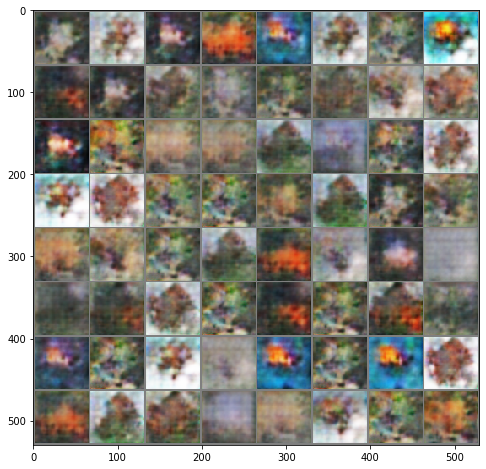

Epoch 430
Current Discriminator Accuracy = 34.214285714285715
Current Discriminator Positives Accuracy = 27.428571428571427
Current Discriminator Negatives Accuracy = 41.0
Current Generator Accuracy = 23.0
0.6986372981752668 0.6939195990562439
Epoch 431
Current Discriminator Accuracy = 24.857142857142858
Current Discriminator Positives Accuracy = 21.857142857142858
Current Discriminator Negatives Accuracy = 27.857142857142858
Current Generator Accuracy = 36.142857142857146
0.689956077507564 0.6988974554198129
Epoch 432
Current Discriminator Accuracy = 31.857142857142858
Current Discriminator Positives Accuracy = 16.0
Current Discriminator Negatives Accuracy = 47.714285714285715
Current Generator Accuracy = 16.285714285714285
0.7057700327464512 0.6951672945703778
Epoch 433
Current Discriminator Accuracy = 27.285714285714285
Current Discriminator Positives Accuracy = 29.571428571428573
Current Discriminator Negatives Accuracy = 25.0
Current Generator Accuracy = 39.0
0.6904224157333374 0.

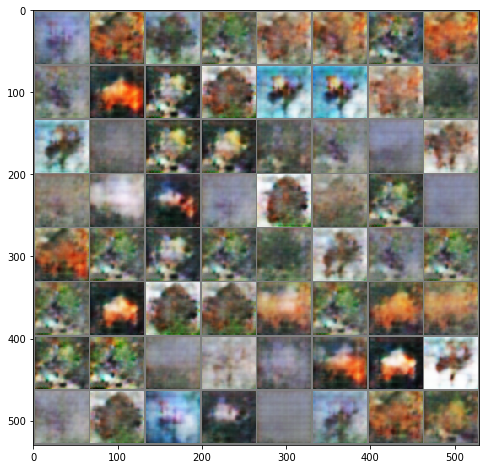

Epoch 440
Current Discriminator Accuracy = 27.142857142857146
Current Discriminator Positives Accuracy = 20.142857142857142
Current Discriminator Negatives Accuracy = 34.142857142857146
Current Generator Accuracy = 29.857142857142858
0.6955391849790301 0.70053745167596
Epoch 441
Current Discriminator Accuracy = 36.785714285714285
Current Discriminator Positives Accuracy = 39.857142857142854
Current Discriminator Negatives Accuracy = 33.714285714285715
Current Generator Accuracy = 30.285714285714285
0.6956590669495719 0.6905336805752346
Epoch 442
Current Discriminator Accuracy = 25.14285714285714
Current Discriminator Positives Accuracy = 32.857142857142854
Current Discriminator Negatives Accuracy = 17.428571428571427
Current Generator Accuracy = 46.57142857142857
0.681293249130249 0.7012444904872349
Epoch 443
Current Discriminator Accuracy = 34.35714285714286
Current Discriminator Positives Accuracy = 36.57142857142857
Current Discriminator Negatives Accuracy = 32.142857142857146
Curre

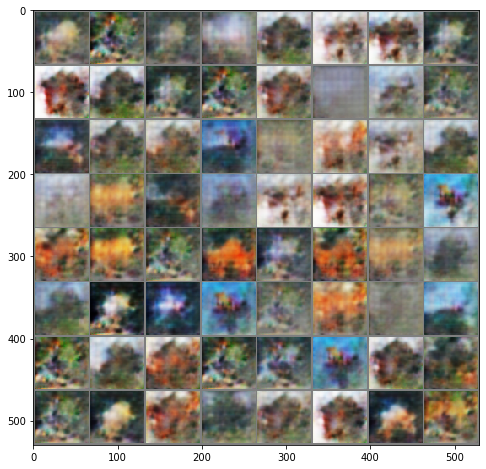

Epoch 450
Current Discriminator Accuracy = 39.5
Current Discriminator Positives Accuracy = 31.142857142857142
Current Discriminator Negatives Accuracy = 47.857142857142854
Current Generator Accuracy = 16.142857142857142
0.7141428419521877 0.6879284467015948
Epoch 451
Current Discriminator Accuracy = 28.642857142857142
Current Discriminator Positives Accuracy = 26.428571428571427
Current Discriminator Negatives Accuracy = 30.857142857142858
Current Generator Accuracy = 33.142857142857146
0.6922065700803485 0.6996672068323407
Epoch 452
Current Discriminator Accuracy = 32.5
Current Discriminator Positives Accuracy = 30.285714285714285
Current Discriminator Negatives Accuracy = 34.714285714285715
Current Generator Accuracy = 29.285714285714285
0.6941407748631069 0.6968697139195034
Epoch 453
Current Discriminator Accuracy = 37.07142857142857
Current Discriminator Positives Accuracy = 38.285714285714285
Current Discriminator Negatives Accuracy = 35.857142857142854
Current Generator Accuracy 

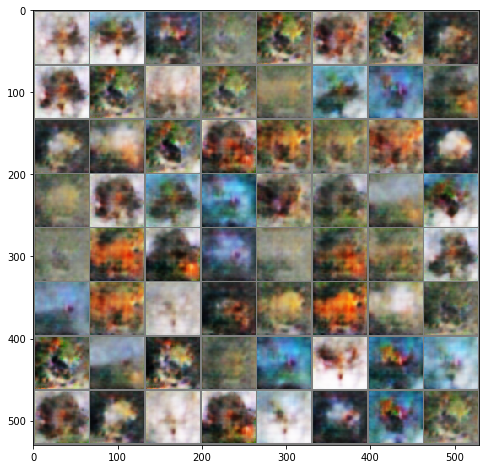

Epoch 460
Current Discriminator Accuracy = 36.714285714285715
Current Discriminator Positives Accuracy = 40.0
Current Discriminator Negatives Accuracy = 33.42857142857143
Current Generator Accuracy = 30.571428571428573
0.6964995520455497 0.6890737754958016
Epoch 461
Current Discriminator Accuracy = 27.42857142857143
Current Discriminator Positives Accuracy = 26.142857142857142
Current Discriminator Negatives Accuracy = 28.714285714285715
Current Generator Accuracy = 35.285714285714285
0.6899853604180473 0.6991825784955706
Epoch 462
Current Discriminator Accuracy = 31.142857142857146
Current Discriminator Positives Accuracy = 29.142857142857142
Current Discriminator Negatives Accuracy = 33.142857142857146
Current Generator Accuracy = 30.857142857142858
0.6920766915593829 0.6964155350412641
Epoch 463
Current Discriminator Accuracy = 38.14285714285714
Current Discriminator Positives Accuracy = 33.57142857142857
Current Discriminator Negatives Accuracy = 42.714285714285715
Current Generato

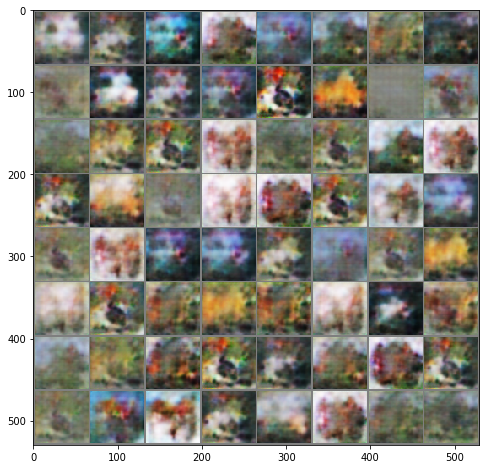

Epoch 470
Current Discriminator Accuracy = 34.14285714285714
Current Discriminator Positives Accuracy = 22.428571428571427
Current Discriminator Negatives Accuracy = 45.857142857142854
Current Generator Accuracy = 18.142857142857142
0.7072377375194004 0.695502051285335
Epoch 471
Current Discriminator Accuracy = 32.07142857142857
Current Discriminator Positives Accuracy = 21.857142857142858
Current Discriminator Negatives Accuracy = 42.285714285714285
Current Generator Accuracy = 21.714285714285715
0.7054082921573094 0.6984990920339312
Epoch 472
Current Discriminator Accuracy = 35.142857142857146
Current Discriminator Positives Accuracy = 29.857142857142858
Current Discriminator Negatives Accuracy = 40.42857142857143
Current Generator Accuracy = 23.571428571428573
0.70902247939791 0.6934628827231271
Epoch 473
Current Discriminator Accuracy = 31.0
Current Discriminator Positives Accuracy = 21.428571428571427
Current Discriminator Negatives Accuracy = 40.57142857142857
Current Generator A

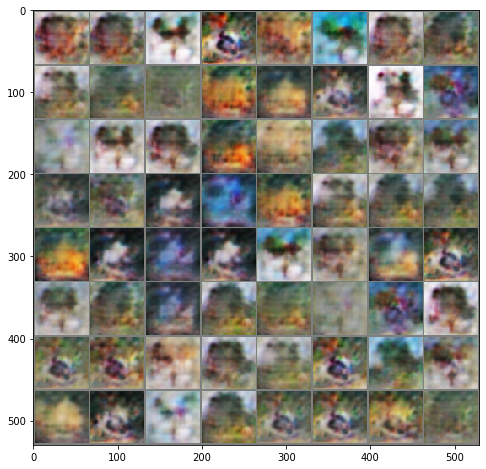

Epoch 480
Current Discriminator Accuracy = 33.92857142857143
Current Discriminator Positives Accuracy = 37.57142857142857
Current Discriminator Negatives Accuracy = 30.285714285714285
Current Generator Accuracy = 33.714285714285715
0.6912178312029157 0.6949018069675991
Epoch 481
Current Discriminator Accuracy = 34.0
Current Discriminator Positives Accuracy = 36.0
Current Discriminator Negatives Accuracy = 32.0
Current Generator Accuracy = 32.0
0.6914344089371818 0.6943044321877616
Epoch 482
Current Discriminator Accuracy = 31.357142857142858
Current Discriminator Positives Accuracy = 25.285714285714285
Current Discriminator Negatives Accuracy = 37.42857142857143
Current Generator Accuracy = 26.571428571428573
0.6998310770307269 0.6961634755134583
Epoch 483
Current Discriminator Accuracy = 30.857142857142854
Current Discriminator Positives Accuracy = 23.428571428571427
Current Discriminator Negatives Accuracy = 38.285714285714285
Current Generator Accuracy = 25.714285714285715
0.7003624

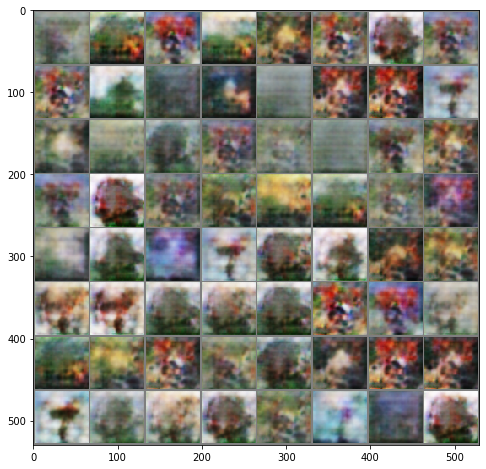

Epoch 490
Current Discriminator Accuracy = 25.642857142857142
Current Discriminator Positives Accuracy = 20.285714285714285
Current Discriminator Negatives Accuracy = 31.0
Current Generator Accuracy = 33.0
0.6968639578138079 0.7014109747750419
Epoch 491
Current Discriminator Accuracy = 34.42857142857143
Current Discriminator Positives Accuracy = 34.714285714285715
Current Discriminator Negatives Accuracy = 34.142857142857146
Current Generator Accuracy = 29.857142857142858
0.6982507279941014 0.695026695728302
Epoch 492
Current Discriminator Accuracy = 36.14285714285714
Current Discriminator Positives Accuracy = 44.857142857142854
Current Discriminator Negatives Accuracy = 27.428571428571427
Current Generator Accuracy = 36.57142857142857
0.691802339894431 0.6878093566213336
Epoch 493
Current Discriminator Accuracy = 26.57142857142857
Current Discriminator Positives Accuracy = 28.0
Current Discriminator Negatives Accuracy = 25.142857142857142
Current Generator Accuracy = 38.85714285714285

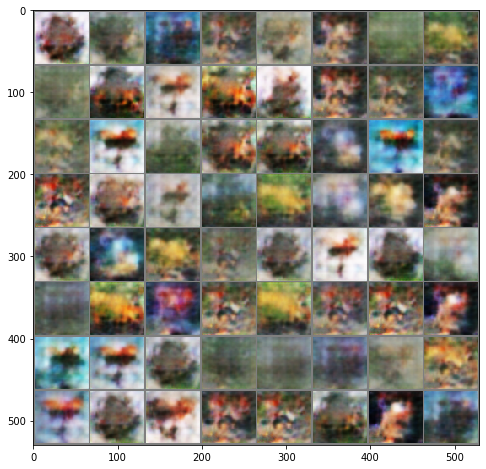

In [0]:
# NZ = 10

image_size = 64
batch_size = 64
n_epochs = 500

gen_lr = 1e-3
dis_lr = 1e-4

device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')

CIFAR100_LABELS_LIST = np.array([
    'apple', 'aquarium_fish', 'baby', 'bear', 'beaver', 'bed', 'bee', 'beetle', 
    'bicycle', 'bottle', 'bowl', 'boy', 'bridge', 'bus', 'butterfly', 'camel', 
    'can', 'castle', 'caterpillar', 'cattle', 'chair', 'chimpanzee', 'clock', 
    'cloud', 'cockroach', 'couch', 'crab', 'crocodile', 'cup', 'dinosaur', 
    'dolphin', 'elephant', 'flatfish', 'forest', 'fox', 'girl', 'hamster', 
    'house', 'kangaroo', 'keyboard', 'lamp', 'lawn_mower', 'leopard', 'lion',
    'lizard', 'lobster', 'man', 'maple_tree', 'motorcycle', 'mountain', 'mouse',
    'mushroom', 'oak_tree', 'orange', 'orchid', 'otter', 'palm_tree', 'pear',
    'pickup_truck', 'pine_tree', 'plain', 'plate', 'poppy', 'porcupine',
    'possum', 'rabbit', 'raccoon', 'ray', 'road', 'rocket', 'rose',
    'sea', 'seal', 'shark', 'shrew', 'skunk', 'skyscraper', 'snail', 'snake',
    'spider', 'squirrel', 'streetcar', 'sunflower', 'sweet_pepper', 'table',
    'tank', 'telephone', 'television', 'tiger', 'tractor', 'train', 'trout',
    'tulip', 'turtle', 'wardrobe', 'whale', 'willow_tree', 'wolf', 'woman',
    'worm'
])

select_class = [1, 4, 15, 26, 59]
print(f"Selected Classes: {CIFAR100_LABELS_LIST[select_class]}")

nz = 10
gen_model = Generator().to(device)
dis_model = Discriminator().to(device)

gen_model.apply(weights_init)
dis_model.apply(weights_init)

optimizer_gen = optim.Adam(gen_model.parameters(), lr=gen_lr, betas=(0.5, 0.999))
optimizer_dis = optim.Adam(dis_model.parameters(), lr=dis_lr, betas=(0.5, 0.999))

print(summary(gen_model, input_size=(nz,1,1)))
print(gen_model)
print(summary(dis_model, input_size=(3,64,64)))
print(dis_model)
#exit(0)

true_labels = 0.0   # CHANGE TO ZERO TO FLIP LABELS

d_true_labels = Variable(torch.Tensor(batch_size).fill_(true_labels), requires_grad=False).to(device)
g_labels = Variable(torch.Tensor(batch_size).fill_(1.0-true_labels), requires_grad=False).to(device)

place_holder_true = np.ones([batch_size]) * true_labels
place_holder_false = np.ones([batch_size]) * (1.0-true_labels)

loss = nn.BCELoss().to(device)

loss_list = []

disc_dataloader = dataloaders()

for epoch in range(n_epochs):
    print("Epoch {}".format(epoch))

    total = len(disc_dataloader) * batch_size * 2
    #total = 10000 * batch_size * 2
    correct_pos = 0.0
    correct_neg = 0.0
    gen_acc = 0.0

    disc_loss_epoch = 0
    gen_loss_epoch = 0

    #for batch_id, (true_images,_) in enumerate(disc_dataloader, 0): # For MNIST Example
    for batch_id, (true_images,_) in enumerate(disc_dataloader, 0):
        gen_model.train()
        dis_model.train()

        optimizer_dis.zero_grad()
        gen_inp_1 = torch.randn(batch_size, nz, 1, 1, device=device, requires_grad=False)

        # gen_inp = gen_inp.to(device)
        fake_images = gen_model(gen_inp_1)
        # TRAINING DISCRIMINATOR

        true_images = true_images.to(device)
          
        # print(loss(dis_model(true_images), d_true_labels))
        # print(loss(dis_model(fake_images.detach()), g_labels))
        d_true_loss = loss(dis_model(true_images), d_true_labels)
        d_fake_loss = loss(dis_model(fake_images.detach()), g_labels)  # Have to detach from graph for some reason

        d_loss = (d_true_loss + d_fake_loss) / 2

        # if d_loss.item()>0.6:
        #    print("discriminator updated")
        d_true_loss.backward()
        d_fake_loss.backward()
        optimizer_dis.step()
        # if g_loss.item()>0.75


        # TRAINING GENERATOR

        optimizer_gen.zero_grad()

        # CREATING A BATCH OF RANDOM NOISE IN [0,1] FOR GENERATOR INPUT
        #gen_inp = Variable(torch.Tensor(np.random.normal(0, 1, (batch_size, 100, 1, 1))),requires_grad=False)
        #print(gen_inp[0:5])

        #save_image(fake_images[0:32], "img{}.png".format(batch_id%5), nrow=8, padding=2, normalize=True)

        #print(fake_images.size())
        gen_loss = loss(dis_model(fake_images), d_true_labels)
        gen_loss.backward()
        optimizer_gen.step()

        gen_loss_epoch += gen_loss.item()
        disc_loss_epoch += d_loss.item()
        #print(gen_loss.item(), d_loss.item())

        with torch.no_grad():
            outputs = dis_model(true_images)
            #_, predicted = torch.max(outputs.data, 1)
            #print(outputs)
            predicted = (outputs > 0.5).to("cpu").numpy()
            batch_disc_acc = (predicted == place_holder_true).sum()/batch_size
            correct_pos += (predicted == place_holder_true).sum()

            outputs = dis_model(fake_images.detach())
            #print(outputs)
            #_, predicted = torch.max(outputs.data, 1)
            predicted = (outputs > 0.5).to("cpu").numpy()
            #print(predicted, place_holder_false)
            #print((predicted == place_holder_false).sum())
            correct_neg += (predicted == place_holder_false).sum()

            outputs = dis_model(fake_images.detach())
            # _, predicted = torch.max(outputs.data, 1)
            predicted = (outputs > 0.5).to("cpu").numpy()
            batch_gen_acc = (predicted == place_holder_true).sum()/batch_size
            gen_acc += (predicted == place_holder_true).sum()

        #print(batch_gen_acc, batch_disc_acc+(1-batch_gen_acc))
        #if batch_disc_acc+(1-batch_gen_acc)<0.4:
        #     print("discriminator updated")
        #     d_loss.backward()
        #     optimizer_dis.step()
        #if batch_gen_acc<0.75:
        #    print("generator updated")
        #    gen_loss.backward()
        #    optimizer_gen.step()


    correct_pos/=total
    correct_neg/=total
    gen_acc/=(total / 2)

    print("Current Discriminator Accuracy = {}".format(correct_pos+correct_neg))
    print("Current Discriminator Positives Accuracy = {}".format(correct_pos*2))
    print("Current Discriminator Negatives Accuracy = {}".format(correct_neg*2))
    print("Current Generator Accuracy = {}".format(gen_acc))

    loss_list.append((gen_loss_epoch/len(disc_dataloader),disc_loss_epoch/len(disc_dataloader)))
    import pickle
    with open("./saved_data/loss_epoch_ImageNet", "wb") as f:
        pickle.dump(loss_list, f)

    print(gen_loss_epoch / len(disc_dataloader), disc_loss_epoch / len(disc_dataloader))

    if epoch==0:
          print("SAMPLE OF TRUE IMAGES..")
          true_images = true_images.cpu().detach()
          show(make_grid(true_images, nrow=8))

    if ((epoch+1)%10)==0:
        generate_images(gen_model, epoch, 64)
    # show(make_grid(true_images, nrow=8, normalize=False))


    torch.save(gen_model.state_dict(), "./saved_data/generator_ImageNet")
    torch.save(dis_model.state_dict(), "./saved_datadiscriminator_ImageNet")